In [2]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [3]:
%cd /content/drive/MyDrive/Proactiveware/

/content/drive/.shortcut-targets-by-id/1AXeAI-Dkxt_gi04CGs4FtrmQR_QWfIlR/Proactiveware


In [ ]:
# install dependencies: (use cu101 because colab has CUDA 10.1)
!pip install -U torch==1.5 torchvision==0.6 -f https://download.pytorch.org/whl/cu101/torch_stable.html 
!pip install cython pyyaml==5.1
!pip install -U 'git+https://github.com/cocodataset/cocoapi.git#subdirectory=PythonAPI'
import torch, torchvision
print(torch.__version__, torch.cuda.is_available())
!gcc --version
# opencv is pre-installed on colab

In [ ]:
!python -m pip install pyyaml==5.1
# Detectron2 has not released pre-built binaries for the latest pytorch (https://github.com/facebookresearch/detectron2/issues/4053)
# so we install from source instead. This takes a few minutes.
!python -m pip install 'git+https://github.com/facebookresearch/detectron2.git'

# Install pre-built detectron2 that matches pytorch version, if released:
# See https://detectron2.readthedocs.io/tutorials/install.html for instructions
#!pip install detectron2 -f https://dl.fbaipublicfiles.com/detectron2/wheels/{CUDA_VERSION}/{TORCH_VERSION}/index.html

# exit(0)  # After installation, you may need to "restart runtime" in Colab. This line can also restart runtime

In [7]:
import detectron2
from detectron2.utils.logger import setup_logger
setup_logger()
# import some common libraries
import numpy as np
import cv2
import random
from google.colab.patches import cv2_imshow
# import some common detectron2 utilities
from detectron2 import model_zoo
from detectron2.engine import DefaultPredictor
from detectron2.config import get_cfg
from detectron2.utils.visualizer import Visualizer
from detectron2.data import MetadataCatalog
from detectron2.data.catalog import DatasetCatalog

import os

In [8]:
# !curl -L "https://app.roboflow.com/ds/0Ywnnj8qWM?key=yuvI7oFWGb" > roboflow.zip; unzip roboflow.zip; rm roboflow.zip

In [10]:
DatasetCatalog.clear()
from detectron2.data.datasets import register_coco_instances
register_coco_instances("my_dataset_train", {}, "data/for_coco_v6/train/_annotations.coco.json", "data/for_coco_v6/train")
register_coco_instances("my_dataset_val", {}, "data/for_coco_v6/valid/_annotations.coco.json", "data/for_coco_v6/valid/")
register_coco_instances("my_dataset_test", {}, "data/for_coco_v6/test/_annotations.coco.json", "data/for_coco_v6/test")

MetadataCatalog.get("my_dataset_train")


namespace(name='my_dataset_train',
          json_file='data/for_coco_v6/train/_annotations.coco.json',
          image_root='data/for_coco_v6/train',
          evaluator_type='coco')

In [11]:
# Verify that the COCO dataset has been loaded correctly
datasets = ["my_dataset_train", "my_dataset_val"]
for d in datasets:
    dataset_dicts = DatasetCatalog.get(d)
    for idx, d in enumerate(random.sample(dataset_dicts, 3)):
        print(f"Image {idx}: {d['file_name']}")


[05/20 12:46:22 d2.data.datasets.coco]: Loading data/for_coco_v6/train/_annotations.coco.json takes 10.17 seconds.
WARNING [05/20 12:46:22 d2.data.datasets.coco]: 
Category ids in annotations are not in [1, #categories]! We'll apply a mapping for you.

[05/20 12:46:22 d2.data.datasets.coco]: Loaded 1167 images in COCO format from data/for_coco_v6/train/_annotations.coco.json
Image 0: data/for_coco_v6/train/panel_11_jpeg.rf.3ba2276190fe7a39168d1615abb7023f.jpg
Image 1: data/for_coco_v6/train/map_64-14129867742606_-21-926316335521992_64-14287091702623_-21-921316697918233_0_1500_png.rf.1ee7caf493576efd0023d1851b4b33e0.jpg
Image 2: data/for_coco_v6/train/Screenshot-from-2023-05-18-22-25-54_png.rf.dcec652bdd4247df641f2c1aa72dba58.jpg
WARNING [05/20 12:46:22 d2.data.datasets.coco]: 
Category ids in annotations are not in [1, #categories]! We'll apply a mapping for you.

[05/20 12:46:22 d2.data.datasets.coco]: Loaded 110 images in COCO format from data/for_coco_v6/valid/_annotations.coco.json

WARNING [05/20 12:47:09 d2.data.datasets.coco]: 
Category ids in annotations are not in [1, #categories]! We'll apply a mapping for you.

[05/20 12:47:09 d2.data.datasets.coco]: Loaded 1167 images in COCO format from data/for_coco_v6/train/_annotations.coco.json


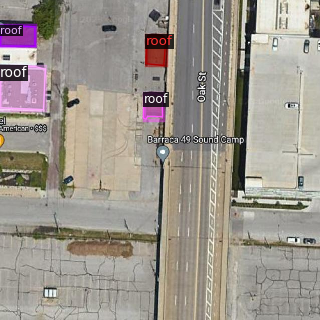

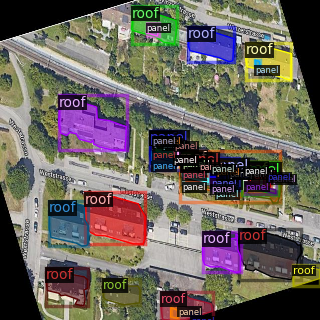

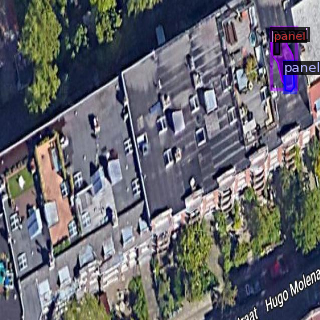

In [12]:
#visualize training data
my_dataset_train_metadata = MetadataCatalog.get("my_dataset_train")
dataset_dicts = DatasetCatalog.get("my_dataset_train")

import random
from detectron2.utils.visualizer import Visualizer

for d in random.sample(dataset_dicts, 3):
    img = cv2.imread(d["file_name"])
    visualizer = Visualizer(img[:, :, ::-1], metadata=my_dataset_train_metadata, scale=0.5)
    vis = visualizer.draw_dataset_dict(d)
    cv2_imshow(vis.get_image()[:, :, ::-1])

# Train Custom Detectron2 Detector

In [13]:
#We are importing our own Trainer Module here to use the COCO validation evaluation during training. Otherwise no validation eval occurs.

from detectron2.engine import DefaultTrainer
from detectron2.evaluation import COCOEvaluator

class CocoTrainer(DefaultTrainer):

  @classmethod
  def build_evaluator(cls, cfg, dataset_name, output_folder=None):

    if output_folder is None:
        os.makedirs("coco_eval", exist_ok=True)
        output_folder = "coco_eval"

    return COCOEvaluator(dataset_name, cfg, False, output_folder)

In [13]:
#from .detectron2.tools.train_net import Trainer
#from detectron2.engine import DefaultTrainer
# select from modelzoo here: https://github.com/facebookresearch/detectron2/blob/master/MODEL_ZOO.md#coco-object-detection-baselines

from detectron2.config import get_cfg
#from detectron2.evaluation.coco_evaluation import COCOEvaluator
import os

cfg = get_cfg()
cfg.merge_from_file(model_zoo.get_config_file("COCO-Detection/faster_rcnn_X_101_32x8d_FPN_3x.yaml"))
cfg.DATASETS.TRAIN = ("my_dataset_train",)
cfg.DATASETS.TEST = ("my_dataset_val",)

cfg.DATALOADER.NUM_WORKERS = 4
cfg.MODEL.WEIGHTS = model_zoo.get_checkpoint_url("COCO-Detection/faster_rcnn_X_101_32x8d_FPN_3x.yaml")  # Let training initialize from model zoo
cfg.SOLVER.IMS_PER_BATCH = 4
cfg.SOLVER.BASE_LR = 0.001

cfg.SOLVER.WARMUP_ITERS = 1000
cfg.SOLVER.MAX_ITER = 500 #adjust up if val mAP is still rising, adjust down if overfit
cfg.SOLVER.STEPS = (1000, 1500)
cfg.SOLVER.GAMMA = 0.05

cfg.MODEL.ROI_HEADS.BATCH_SIZE_PER_IMAGE = 64
cfg.MODEL.ROI_HEADS.NUM_CLASSES = 3 #your number of classes + 1

cfg.TEST.EVAL_PERIOD = 500


# cfg = get_cfg()
# cfg.merge_from_file(model_zoo.get_config_file("COCO-InstanceSegmentation/mask_rcnn_R_50_FPN_3x.yaml"))
# cfg.DATASETS.TRAIN = ("balloon_train",)
# cfg.DATASETS.TEST = ()
# cfg.DATALOADER.NUM_WORKERS = 2
# cfg.MODEL.WEIGHTS = model_zoo.get_checkpoint_url("COCO-InstanceSegmentation/mask_rcnn_R_50_FPN_3x.yaml")  # Let training initialize from model zoo
# cfg.SOLVER.IMS_PER_BATCH = 2
# cfg.SOLVER.BASE_LR = 0.00025  # pick a good LR
# cfg.SOLVER.MAX_ITER = 300    # 300 iterations seems good enough for this toy dataset; you will need to train longer for a practical dataset
# cfg.SOLVER.STEPS = []        # do not decay learning rate
# cfg.MODEL.ROI_HEADS.BATCH_SIZE_PER_IMAGE = 128   # faster, and good enough for this toy dataset (default: 512)
# cfg.MODEL.ROI_HEADS.NUM_CLASSES = 1  # only has one class (ballon). 



In [14]:
os.makedirs(cfg.OUTPUT_DIR, exist_ok=True)
trainer = CocoTrainer(cfg)
trainer.resume_or_load(resume=False)
trainer.train()

[05/20 06:43:18 d2.engine.defaults]: Model:
GeneralizedRCNN(
  (backbone): FPN(
    (fpn_lateral2): Conv2d(256, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output2): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral3): Conv2d(512, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output3): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral4): Conv2d(1024, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output4): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral5): Conv2d(2048, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output5): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (top_block): LastLevelMaxPool()
    (bottom_up): ResNet(
      (stem): BasicStem(
        (conv1): Conv2d(
          3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False
          (norm): FrozenBatchNorm2d(num_features=64, eps=1e-05)
        )
      )
      (res

/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py:560: UserWarning: This DataLoader will create 4 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  warnings.warn(_create_warning_msg(
model_final_68b088.pkl: 421MB [00:05, 76.7MB/s]                          
roi_heads.box_predictor.bbox_pred.{bias, weight}
roi_heads.box_predictor.cls_score.{bias, weight}


[05/20 06:43:24 d2.engine.train_loop]: Starting training from iteration 0


/usr/local/lib/python3.10/dist-packages/torch/functional.py:504: UserWarning: torch.meshgrid: in an upcoming release, it will be required to pass the indexing argument. (Triggered internally at ../aten/src/ATen/native/TensorShape.cpp:3483.)
  return _VF.meshgrid(tensors, **kwargs)  # type: ignore[attr-defined]


[05/20 06:44:21 d2.utils.events]:  eta: 0:19:09  iter: 19  total_loss: 2.393  loss_cls: 1.357  loss_box_reg: 0.6744  loss_rpn_cls: 0.3132  loss_rpn_loc: 0.03273    time: 2.3367  last_time: 2.2047  data_time: 0.0622  last_data_time: 0.0112   lr: 3.8962e-05  max_mem: 6856M
[05/20 06:45:12 d2.utils.events]:  eta: 0:18:19  iter: 39  total_loss: 1.992  loss_cls: 0.979  loss_box_reg: 0.6808  loss_rpn_cls: 0.2454  loss_rpn_loc: 0.05183    time: 2.3675  last_time: 2.5167  data_time: 0.0129  last_data_time: 0.0108   lr: 7.8922e-05  max_mem: 6856M
[05/20 06:45:59 d2.utils.events]:  eta: 0:17:25  iter: 59  total_loss: 1.674  loss_cls: 0.7679  loss_box_reg: 0.7593  loss_rpn_cls: 0.1109  loss_rpn_loc: 0.04341    time: 2.3550  last_time: 2.2797  data_time: 0.0124  last_data_time: 0.0138   lr: 0.00011888  max_mem: 6857M
[05/20 06:46:46 d2.utils.events]:  eta: 0:16:24  iter: 79  total_loss: 1.606  loss_cls: 0.6441  loss_box_reg: 0.8294  loss_rpn_cls: 0.09757  loss_rpn_loc: 0.03557    time: 2.3582  las

/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py:560: UserWarning: This DataLoader will create 4 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  warnings.warn(_create_warning_msg(


[05/20 07:03:47 d2.evaluation.evaluator]: Inference done 11/110. Dataloading: 0.0029 s/iter. Inference: 0.1909 s/iter. Eval: 0.0005 s/iter. Total: 0.1943 s/iter. ETA=0:00:19
[05/20 07:03:52 d2.evaluation.evaluator]: Inference done 38/110. Dataloading: 0.0024 s/iter. Inference: 0.1897 s/iter. Eval: 0.0004 s/iter. Total: 0.1926 s/iter. ETA=0:00:13
[05/20 07:03:57 d2.evaluation.evaluator]: Inference done 64/110. Dataloading: 0.0027 s/iter. Inference: 0.1906 s/iter. Eval: 0.0005 s/iter. Total: 0.1939 s/iter. ETA=0:00:08
[05/20 07:04:02 d2.evaluation.evaluator]: Inference done 88/110. Dataloading: 0.0032 s/iter. Inference: 0.1953 s/iter. Eval: 0.0007 s/iter. Total: 0.1994 s/iter. ETA=0:00:04
[05/20 07:04:07 d2.evaluation.evaluator]: Total inference time: 0:00:20.901328 (0.199060 s / iter per device, on 1 devices)
[05/20 07:04:07 d2.evaluation.evaluator]: Total inference pure compute time: 0:00:20 (0.194089 s / iter per device, on 1 devices)
[05/20 07:04:07 d2.evaluation.coco_evaluation]: Pr

In [15]:
# Look at training curves in tensorboard:
%load_ext tensorboard
%tensorboard --logdir output

<IPython.core.display.Javascript object>

In [16]:
#test evaluation
from detectron2.data import DatasetCatalog, MetadataCatalog, build_detection_test_loader
from detectron2.evaluation import COCOEvaluator, inference_on_dataset

cfg.MODEL.WEIGHTS = os.path.join(cfg.OUTPUT_DIR, "model_final.pth")
cfg.MODEL.ROI_HEADS.SCORE_THRESH_TEST = 0.85
predictor = DefaultPredictor(cfg)
evaluator = COCOEvaluator("my_dataset_test", cfg, False, output_dir="./output/")
val_loader = build_detection_test_loader(cfg, "my_dataset_test")
inference_on_dataset(trainer.model, val_loader, evaluator)

[05/20 07:06:15 d2.checkpoint.detection_checkpoint]: [DetectionCheckpointer] Loading from ./output/model_final.pth ...
WARNING [05/20 07:06:16 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass in explicit arguments instead.
WARNING [05/20 07:06:17 d2.data.datasets.coco]: 
Category ids in annotations are not in [1, #categories]! We'll apply a mapping for you.

[05/20 07:06:17 d2.data.datasets.coco]: Loaded 62 images in COCO format from data/for_coco_v6/test/_annotations.coco.json
[05/20 07:06:17 d2.data.build]: Distribution of instances among all 3 categories:
|  category  | #instances   |  category  | #instances   |  category  | #instances   |
|:----------:|:-------------|:----------:|:-------------|:----------:|:-------------|
| roof-panel | 0            |   panel    | 142          |    roof    | 247          |
|            |              |            |              |            |              |
|   total    | 389       

/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py:560: UserWarning: This DataLoader will create 4 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  warnings.warn(_create_warning_msg(


[05/20 07:06:20 d2.evaluation.evaluator]: Inference done 11/62. Dataloading: 0.0033 s/iter. Inference: 0.1845 s/iter. Eval: 0.0004 s/iter. Total: 0.1882 s/iter. ETA=0:00:09
[05/20 07:06:25 d2.evaluation.evaluator]: Inference done 39/62. Dataloading: 0.0036 s/iter. Inference: 0.1792 s/iter. Eval: 0.0004 s/iter. Total: 0.1837 s/iter. ETA=0:00:04
[05/20 07:06:29 d2.evaluation.evaluator]: Total inference time: 0:00:10.480745 (0.183873 s / iter per device, on 1 devices)
[05/20 07:06:29 d2.evaluation.evaluator]: Total inference pure compute time: 0:00:10 (0.177793 s / iter per device, on 1 devices)
[05/20 07:06:30 d2.evaluation.coco_evaluation]: Preparing results for COCO format ...
[05/20 07:06:30 d2.evaluation.coco_evaluation]: Saving results to ./output/coco_instances_results.json
[05/20 07:06:30 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.01s)
creating index...
index created!
[05/20 07:06:30 d2.evaluation.f

OrderedDict([('bbox',
              {'AP': 31.20872734906859,
               'AP50': 51.501583683330786,
               'AP75': 33.22295739218363,
               'APs': 11.854557750853326,
               'APm': 33.724097236728525,
               'APl': 37.77818331524294,
               'AP-roof-panel': nan,
               'AP-panel': 23.563147725290147,
               'AP-roof': 38.85430697284703})])

In [1]:
# %ls /content/drive/MyDrive/Proactiveware/output

In [21]:
cfg.MODEL.WEIGHTS = os.path.join(cfg.OUTPUT_DIR, "model_final.pth")
cfg.DATASETS.TEST = ("my_dataset_test", )
cfg.MODEL.ROI_HEADS.SCORE_THRESH_TEST = 0.7   # set the testing threshold for this model
predictor = DefaultPredictor(cfg)
test_metadata = MetadataCatalog.get("my_dataset_test")

[05/20 07:11:48 d2.checkpoint.detection_checkpoint]: [DetectionCheckpointer] Loading from ./output/model_final.pth ...


In [ ]:
  cfg = get_cfg()
  cfg.merge_from_file(model_zoo.get_config_file("COCO-Detection/faster_rcnn_X_101_32x8d_FPN_3x.yaml"))
  cfg.DATASETS.TEST = ()
  cfg.DATALOADER.NUM_WORKERS = 0
  cfg.MODEL.ROI_HEADS.NUM_CLASSES = 1
  cfg.MODEL.WEIGHTS = os.path.join(cfg.OUTPUT_DIR, "model_final.pth")
  cfg.MODEL.ROI_HEADS.SCORE_THRESH_TEST = 0.7   # set the testing threshold for this model
  cfg.DATASETS.TRAIN = ("my_dataset_train",)
  cfg.DATASETS.TEST = ("my_dataset_val",)
  cfg.MODEL.DEVICE='cpu'

  predictor = DefaultPredictor(cfg)
  test_metadata = MetadataCatalog.get("my_dataset_test")

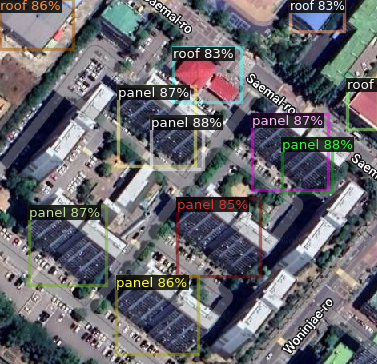

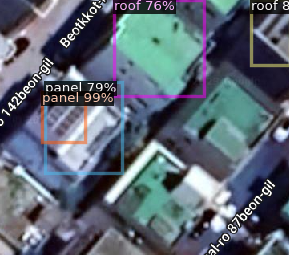

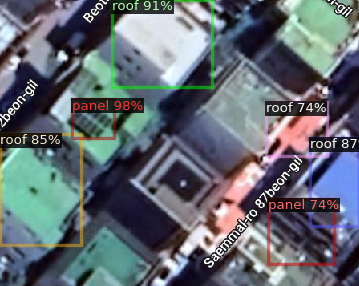

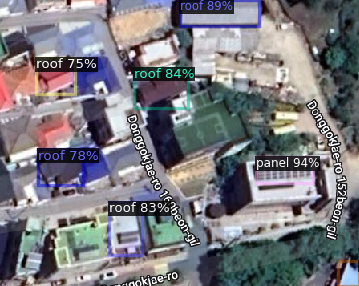

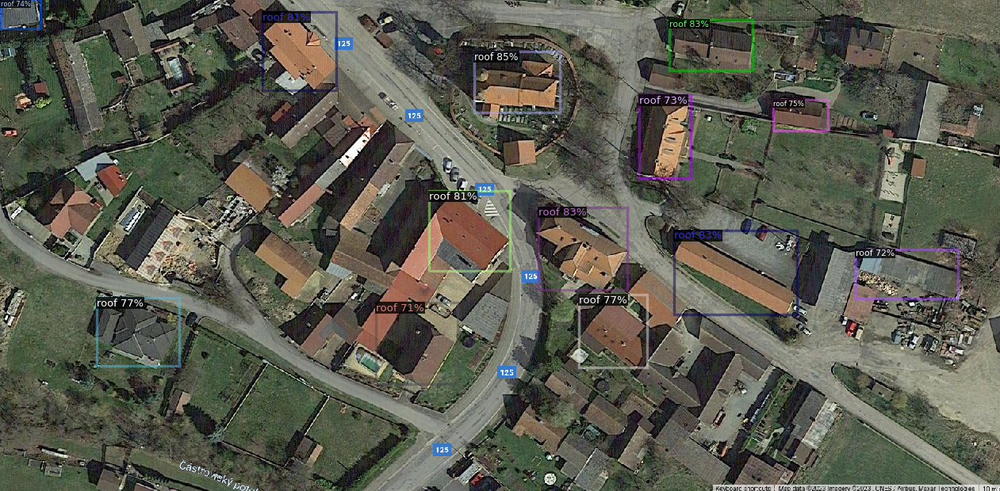

...

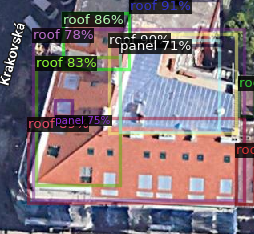

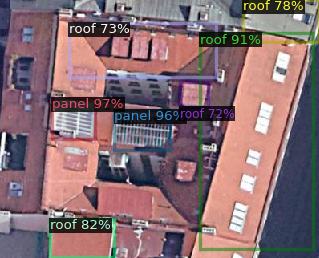

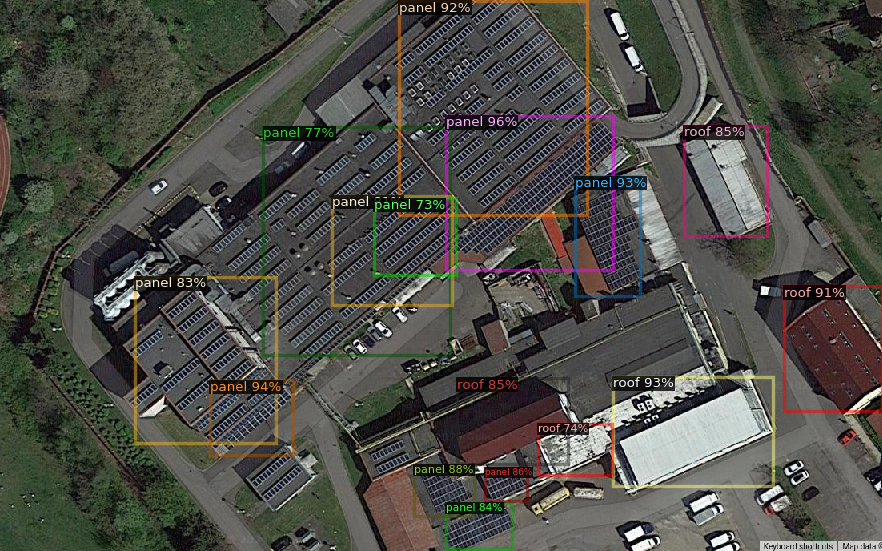

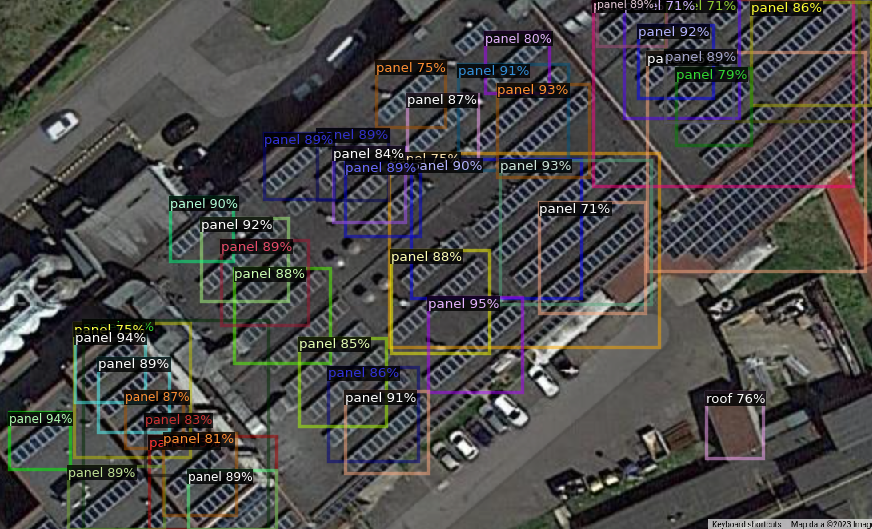

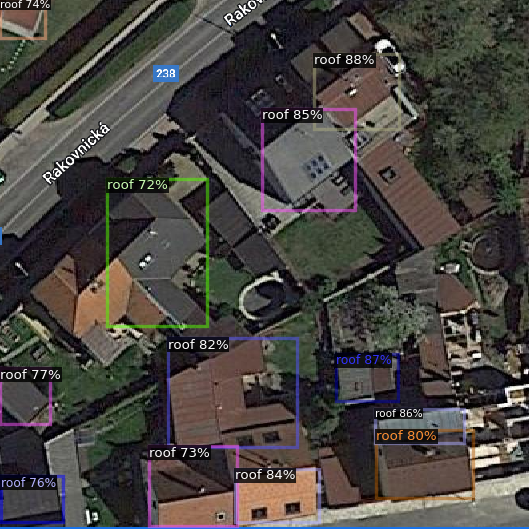

In [26]:
from detectron2.utils.visualizer import ColorMode
import glob

for imageName in glob.glob('/content/drive/MyDrive/Proactiveware/data/folder_for_test_pic/new/*png'):
  im = cv2.imread(imageName)
  outputs = predictor(im)
  v = Visualizer(im[:, :, ::-1],
                metadata=test_metadata, 
                scale=0.8
                 )
  out = v.draw_instance_predictions(outputs["instances"].to("cpu"))
  cv2_imshow(out.get_image()[:, :, ::-1])
  cv2.imwrite(imageName + "predict_fastRCNN.png", out.get_image()[:, :, ::-1], )